# Audio Processing: Week 1 – Signal Fundamentals, Resampling & Equalization

Minggu ini kita akan mempelajari konsep fundamental dalam pemrosesan sinyal audio dengan fokus pada **resampling** dan **equalization**. Kedua teknik ini sangat penting dalam aplikasi audio profesional.

## Tujuan Pembelajaran:

- **Memahami ulang** konsep dasar dari minggu pertama (loading, waveform, spectrogram, MFCCs)
- **Menguasai resampling** untuk mengubah sample rate audio
- **Memahami aliasing** dan cara mencegahnya
- **Menerapkan filtering & equalization** untuk manipulasi frekuensi
- **Praktik hands-on** dengan berbagai jenis filter audio

## Aplikasi di Dunia Nyata:

- **Audio Production**: EQ untuk mixing dan mastering musik
- **Broadcasting**: Resampling untuk standar siaran yang berbeda
- **Streaming**: Konversi sample rate untuk bandwidth yang optimal
- **Audio Restoration**: Noise removal dan enhancement kualitas audio
- **Telecommunications**: Filter untuk clarity pada panggilan suara

**File Audio:** Kita akan menggunakan audio percakapan 1 menit yang sebelumnya telah anda generate menggunakan Google AI Studio

In [2]:
# Setup & Import Libraries
# Pastikan semua library terinstal: pip install librosa soundfile numpy scipy matplotlib ipython

import librosa
import soundfile as sf
import numpy as np
import scipy.signal
import matplotlib.pyplot as plt
from IPython.display import Audio
import os
import warnings

# Filter warnings untuk output yang lebih bersih
warnings.filterwarnings('ignore')

# Set style plot untuk visualisasi yang lebih menarik
plt.style.use('default')
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.alpha'] = 0.3

# Tampilkan versi pustaka
print("🔧 SETUP PUSTAKA")
print("=" * 40)
print(f"Librosa: {librosa.__version__}")
print(f"NumPy: {np.__version__}")
print(f"SciPy: {scipy.__version__}")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print("✅ Semua pustaka berhasil dimuat!")
print()

🔧 SETUP PUSTAKA
Librosa: 0.11.0
NumPy: 2.2.6
SciPy: 1.15.3
Matplotlib: 3.10.6
✅ Semua pustaka berhasil dimuat!



## Recap Week 0: Dasar-Dasar Audio Processing

Sebelum masuk ke materi baru, mari kita ulas kembali konsep fundamental dari Week 0:

### 1. **Loading Audio**
- Memuat file audio dengan `librosa.load()`
- Memahami metadata: sample rate, durasi, kanal
- Konversi format dan normalisasi

### 2. **Waveform Analysis**
- Visualisasi domain waktu (time-domain)
- Interpretasi amplitudo dan temporal pattern
- Deteksi clipping dan analisis statistik

### 3. **Spectrogram (STFT)**
- Transformasi dari time-domain ke frequency-domain
- Parameter penting: n_fft, hop_length, window
- Interpretasi magnitude dan phase

### 4. **MFCC & Mel-Spectrogram**
- Skala mel untuk persepsi manusia
- MFCC sebagai fitur untuk machine learning
- Aplikasi dalam speech recognition

**💡 Tip**: Konsep-konsep ini adalah fondasi untuk memahami resampling dan filtering yang akan kita pelajari hari ini!

🎵 AUDIO LOADED
✅ Berhasil memuat: /Users/martinmanullang/Developer/if4021-handson/data/audio.wav
📊 Shape: (1529543,)
🎵 Sample rate: 24,000 Hz
⏱️ Durasi: 63.73 detik
📈 Amplitude range: -1.000 to 1.000
🔊 RMS Level: 0.116


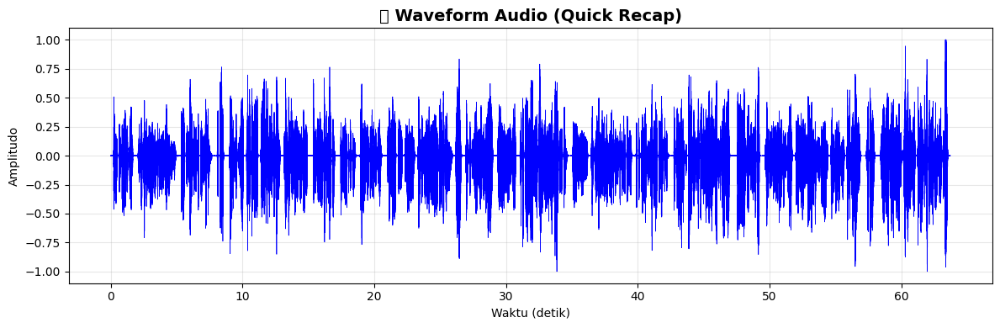

🔊 Audio Player:


In [3]:
# Memuat Audio - Quick Recap dari Week 0
PATH_AUDIO = os.path.join(os.getcwd(), 'data', 'audio.wav')

# Load audio dengan error handling
try:
    if os.path.exists(PATH_AUDIO):
        y, sr = librosa.load(PATH_AUDIO, sr=None)  # sr=None mempertahankan sample rate asli
        source_info = f"✅ Berhasil memuat: {PATH_AUDIO}"
    else:
        # Fallback ke sample librosa
        y, sr = librosa.load(librosa.ex('trumpet'), sr=None)
        source_info = "✅ Menggunakan sample audio bawaan librosa (trumpet)"
except Exception as e:
    print(f"❌ Error loading audio: {e}")
    # Buat sinyal sinus sebagai fallback
    sr = 22050
    duration = 3.0
    freq = 440  # A4 note
    t = np.linspace(0, duration, int(sr * duration))
    y = 0.5 * np.sin(2 * np.pi * freq * t)
    source_info = f"✅ Menggunakan sinyal sinus buatan ({freq} Hz)"

# Konversi ke mono jika stereo
if y.ndim > 1:
    y = np.mean(y, axis=0)
    source_info += " - Dikonversi ke mono"

# Normalisasi dan konversi tipe data
y = y.astype(np.float32)

print("🎵 AUDIO LOADED")
print("=" * 40)
print(source_info)
print(f"📊 Shape: {y.shape}")
print(f"🎵 Sample rate: {sr:,} Hz")
print(f"⏱️ Durasi: {len(y)/sr:.2f} detik")
print(f"📈 Amplitude range: {y.min():.3f} to {y.max():.3f}")
print(f"🔊 RMS Level: {np.sqrt(np.mean(y**2)):.3f}")

# Quick waveform visualization
fig, ax = plt.subplots(1, 1, figsize=(12, 4))
t = np.linspace(0, len(y)/sr, len(y))
ax.plot(t, y, color='blue', linewidth=0.5)
ax.set_title('🎵 Waveform Audio (Quick Recap)', fontsize=14, fontweight='bold')
ax.set_xlabel('Waktu (detik)')
ax.set_ylabel('Amplitudo')
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Audio player
print("🔊 Audio Player:")
display(Audio(y, rate=sr))

## Resampling: Mengubah Sample Rate Audio

**Resampling** adalah proses mengubah sample rate (frekuensi sampling) dari sinyal audio. Ini adalah operasi fundamental yang sangat penting dalam audio processing.

### Mengapa Resampling Penting?

1. **Konsistensi Dataset**: Memastikan semua audio memiliki sample rate yang sama
2. **Optimisasi Storage**: Sample rate rendah = file lebih kecil
3. **Kompatibilitas Hardware**: Berbeda perangkat mendukung sample rate berbeda
4. **Broadcasting Standards**: TV/Radio memiliki standar sample rate tertentu
5. **Real-time Processing**: Menyesuaikan dengan kemampuan processing

### Sample Rate Umum:
- **8 kHz**: Telephony (kualitas telepon)
- **16 kHz**: Speech processing, some VoIP
- **22.05 kHz**: Web audio, game audio
- **44.1 kHz**: CD quality, standar audio
- **48 kHz**: Professional audio, video production
- **96 kHz**: High-resolution audio recording

### Jenis Resampling:

#### 1. **Upsampling (Sample Rate ↑)**
- Menambah jumlah sample dengan interpolasi
- Contoh: 22 kHz → 44.1 kHz
- Tidak menambah informasi frekuensi baru

#### 2. **Downsampling (Sample Rate ↓)**
- Mengurangi jumlah sample
- Contoh: 44.1 kHz → 16 kHz
- Harus hati-hati dengan **aliasing**!

### ⚠️ Masalah Aliasing

**Aliasing** terjadi saat downsampling tanpa filtering yang proper:
- Frekuensi tinggi "terlipat" ke frekuensi rendah
- Menyebabkan distorsi dan artefak yang tidak diinginkan
- **Solusi**: Gunakan anti-aliasing filter (low-pass filter) sebelum downsampling

🔄 RESAMPLING DEMONSTRATION
📊 Audio asli: 24,000 Hz, 1,529,543 samples
🎯 Target sample rate: 16,000 Hz
📉 Rasio downsampling: 0.6667

📊 HASIL RESAMPLING:
  Librosa: 1,019,696 samples
  SciPy:   1,019,695 samples
  Durasi:  63.73 detik
🎯 Target sample rate: 16,000 Hz
📉 Rasio downsampling: 0.6667

📊 HASIL RESAMPLING:
  Librosa: 1,019,696 samples
  SciPy:   1,019,695 samples
  Durasi:  63.73 detik


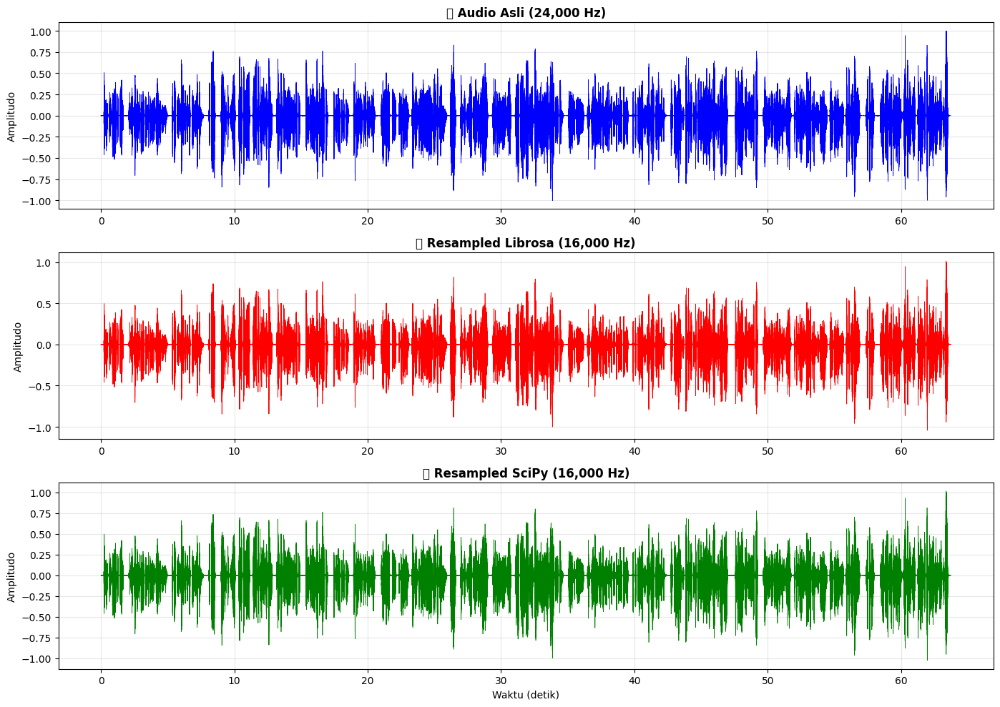

🔊 AUDIO COMPARISON:
Original Audio:


Resampled Audio (Librosa):


✅ Resampling selesai! Audio tersimpan dengan sample rate 16,000 Hz


In [4]:
# Hands-on: Resampling 44.1 kHz → 16 kHz
print("🔄 RESAMPLING DEMONSTRATION")
print("=" * 50)
print(f"📊 Audio asli: {sr:,} Hz, {len(y):,} samples")

# Target sample rate untuk downsampling
target_sr = 16000

# Method 1: Librosa resampling (recommended - dengan anti-aliasing)
y_resampled_librosa = librosa.resample(y, orig_sr=sr, target_sr=target_sr)

# Method 2: SciPy resampling (untuk perbandingan)
# Hitung rasio resampling
resample_ratio = target_sr / sr
num_samples_new = int(len(y) * resample_ratio)
y_resampled_scipy = scipy.signal.resample(y, num_samples_new)

print(f"🎯 Target sample rate: {target_sr:,} Hz")
print(f"📉 Rasio downsampling: {resample_ratio:.4f}")
print()
print("📊 HASIL RESAMPLING:")
print(f"  Librosa: {len(y_resampled_librosa):,} samples")
print(f"  SciPy:   {len(y_resampled_scipy):,} samples")
print(f"  Durasi:  {len(y_resampled_librosa)/target_sr:.2f} detik")

# Visualisasi perbandingan
fig, axes = plt.subplots(3, 1, figsize=(14, 10))

# Plot 1: Audio asli
t_orig = np.linspace(0, len(y)/sr, len(y))
axes[0].plot(t_orig, y, color='blue', linewidth=0.5)
axes[0].set_title(f'🎵 Audio Asli ({sr:,} Hz)', fontsize=12, fontweight='bold')
axes[0].set_ylabel('Amplitudo')
axes[0].grid(True, alpha=0.3)

# Plot 2: Resampled dengan Librosa
t_resamp = np.linspace(0, len(y_resampled_librosa)/target_sr, len(y_resampled_librosa))
axes[1].plot(t_resamp, y_resampled_librosa, color='red', linewidth=0.5)
axes[1].set_title(f'🔄 Resampled Librosa ({target_sr:,} Hz)', fontsize=12, fontweight='bold')
axes[1].set_ylabel('Amplitudo')
axes[1].grid(True, alpha=0.3)

# Plot 3: Resampled dengan SciPy
t_scipy = np.linspace(0, len(y_resampled_scipy)/target_sr, len(y_resampled_scipy))
axes[2].plot(t_scipy, y_resampled_scipy, color='green', linewidth=0.5)
axes[2].set_title(f'🔄 Resampled SciPy ({target_sr:,} Hz)', fontsize=12, fontweight='bold')
axes[2].set_xlabel('Waktu (detik)')
axes[2].set_ylabel('Amplitudo')
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Audio players untuk perbandingan
print("🔊 AUDIO COMPARISON:")
print("Original Audio:")
display(Audio(y, rate=sr))
print("Resampled Audio (Librosa):")
display(Audio(y_resampled_librosa, rate=target_sr))

# Simpan hasil resampling untuk digunakan selanjutnya
y_16k = y_resampled_librosa
sr_16k = target_sr

print(f"✅ Resampling selesai! Audio tersimpan dengan sample rate {sr_16k:,} Hz")

⚠️ DEMONSTRASI ALIASING
🎵 Sinyal test dengan frekuensi: 2000, 10000, 15000 Hz
🎯 Nyquist frequency untuk 16kHz: 8000.0 Hz
⚠️ Frekuensi > 8kHz akan ter-alias!


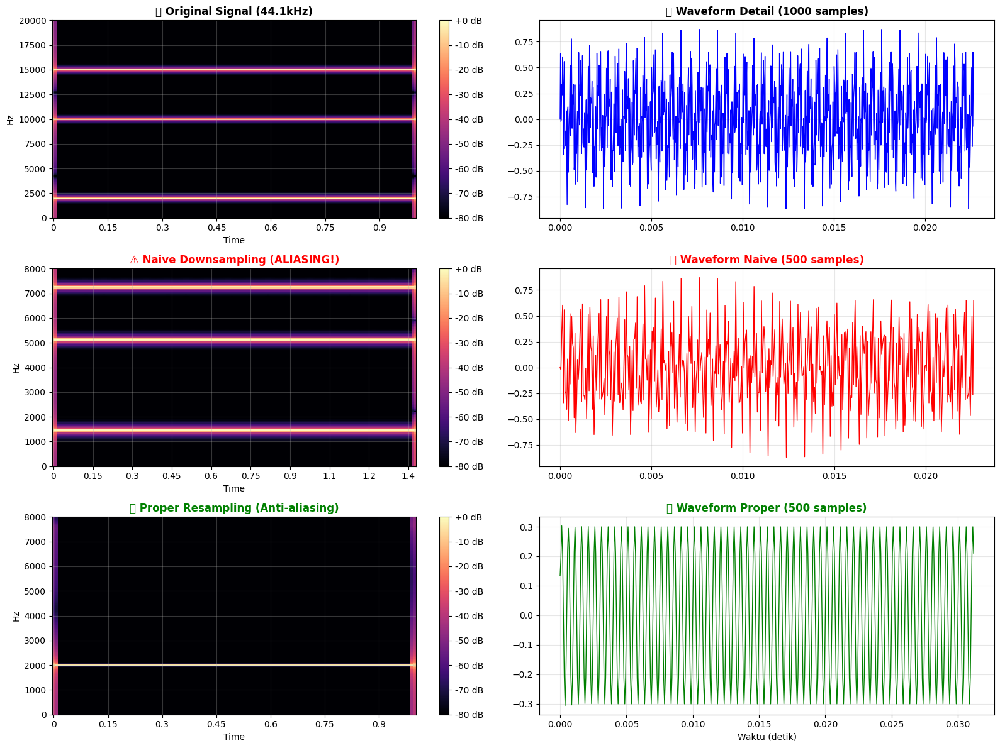

📊 PERHATIKAN PERBEDAAN:
  ⚠️ Naive downsampling: Muncul artefak frekuensi rendah (aliasing)
  ✅ Proper resampling: Frekuensi tinggi di-filter dengan benar

🔊 Audio Comparison:
Naive Downsampling (dengan aliasing):


Proper Resampling (anti-aliasing):


In [5]:
# Demonstrasi Aliasing: Sebelum vs Sesudah Anti-aliasing Filter

print("⚠️ DEMONSTRASI ALIASING")
print("=" * 50)

# Buat sinyal test dengan frekuensi tinggi untuk menunjukkan aliasing
fs_test = 44100
duration = 1.0
t_test = np.linspace(0, duration, int(fs_test * duration))

# Sinyal dengan komponen frekuensi tinggi (di atas Nyquist frequency untuk 16kHz)
freq1 = 2000   # Frekuensi rendah (aman)
freq2 = 10000  # Frekuensi tinggi (akan ter-alias pada 16kHz)
freq3 = 15000  # Frekuensi sangat tinggi (akan ter-alias)

test_signal = (0.3 * np.sin(2 * np.pi * freq1 * t_test) +
               0.3 * np.sin(2 * np.pi * freq2 * t_test) +
               0.3 * np.sin(2 * np.pi * freq3 * t_test))

print(f"🎵 Sinyal test dengan frekuensi: {freq1}, {freq2}, {freq3} Hz")
print(f"🎯 Nyquist frequency untuk 16kHz: {16000/2} Hz")
print(f"⚠️ Frekuensi > 8kHz akan ter-alias!")

# Resampling tanpa anti-aliasing (naive downsampling)
decimation_factor = fs_test // 16000
naive_downsample = test_signal[::decimation_factor]

# Resampling dengan librosa (dengan anti-aliasing)
proper_resample = librosa.resample(test_signal, orig_sr=fs_test, target_sr=16000)

# Visualisasi spectrogram untuk melihat aliasing
fig, axes = plt.subplots(3, 2, figsize=(16, 12))

# Original signal
D_orig = librosa.stft(test_signal, n_fft=1024, hop_length=256)
mag_orig = np.abs(D_orig)
mag_orig_db = librosa.amplitude_to_db(mag_orig, ref=np.max)

img1 = librosa.display.specshow(mag_orig_db, x_axis='time', y_axis='hz',
                               sr=fs_test, hop_length=256, ax=axes[0,0])
axes[0,0].set_title('🎵 Original Signal (44.1kHz)', fontweight='bold')
axes[0,0].set_ylim([0, 20000])
plt.colorbar(img1, ax=axes[0,0], format='%+2.0f dB')

# Waveform original
t_orig_test = np.linspace(0, duration, len(test_signal))
axes[0,1].plot(t_orig_test[:1000], test_signal[:1000], 'b-', linewidth=1)
axes[0,1].set_title('🌊 Waveform Detail (1000 samples)', fontweight='bold')
axes[0,1].grid(True, alpha=0.3)

# Naive downsampling (dengan aliasing)
D_naive = librosa.stft(naive_downsample, n_fft=512, hop_length=128)
mag_naive = np.abs(D_naive)
mag_naive_db = librosa.amplitude_to_db(mag_naive, ref=np.max)

img2 = librosa.display.specshow(mag_naive_db, x_axis='time', y_axis='hz',
                               sr=16000, hop_length=128, ax=axes[1,0])
axes[1,0].set_title('⚠️ Naive Downsampling (ALIASING!)', fontweight='bold', color='red')
axes[1,0].set_ylim([0, 8000])
plt.colorbar(img2, ax=axes[1,0], format='%+2.0f dB')

# Waveform naive
t_naive = np.linspace(0, duration, len(naive_downsample))
axes[1,1].plot(t_naive[:500], naive_downsample[:500], 'r-', linewidth=1)
axes[1,1].set_title('🌊 Waveform Naive (500 samples)', fontweight='bold', color='red')
axes[1,1].grid(True, alpha=0.3)

# Proper resampling (anti-aliasing)
D_proper = librosa.stft(proper_resample, n_fft=512, hop_length=128)
mag_proper = np.abs(D_proper)
mag_proper_db = librosa.amplitude_to_db(mag_proper, ref=np.max)

img3 = librosa.display.specshow(mag_proper_db, x_axis='time', y_axis='hz',
                               sr=16000, hop_length=128, ax=axes[2,0])
axes[2,0].set_title('✅ Proper Resampling (Anti-aliasing)', fontweight='bold', color='green')
axes[2,0].set_ylim([0, 8000])
plt.colorbar(img3, ax=axes[2,0], format='%+2.0f dB')

# Waveform proper
t_proper = np.linspace(0, duration, len(proper_resample))
axes[2,1].plot(t_proper[:500], proper_resample[:500], 'g-', linewidth=1)
axes[2,1].set_title('🌊 Waveform Proper (500 samples)', fontweight='bold', color='green')
axes[2,1].set_xlabel('Waktu (detik)')
axes[2,1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print("📊 PERHATIKAN PERBEDAAN:")
print("  ⚠️ Naive downsampling: Muncul artefak frekuensi rendah (aliasing)")
print("  ✅ Proper resampling: Frekuensi tinggi di-filter dengan benar")
print()
print("🔊 Audio Comparison:")
print("Naive Downsampling (dengan aliasing):")
display(Audio(naive_downsample, rate=16000))
print("Proper Resampling (anti-aliasing):")
display(Audio(proper_resample, rate=16000))

## Filtering & Equalization: Kontrol Frekuensi Audio

**Filtering** adalah proses memodifikasi konten frekuensi dari sinyal audio. **Equalization (EQ)** adalah aplikasi praktis dari filtering untuk menyesuaikan balance frekuensi.

### Jenis-Jenis Filter Dasar:

#### 1. **Low-pass Filter (High-cut)**
- **Fungsi**: Meloloskan frekuensi rendah, memotong frekuensi tinggi
- **Parameter**: Cutoff frequency (fc)
- **Aplikasi**: 
  - Menghilangkan noise frekuensi tinggi
  - Anti-aliasing dalam resampling
  - Mengurangi "brightness" yang berlebihan

#### 2. **High-pass Filter (Low-cut)**
- **Fungsi**: Meloloskan frekuensi tinggi, memotong frekuensi rendah
- **Parameter**: Cutoff frequency (fc)
- **Aplikasi**:
  - Menghilangkan rumble dan low-frequency noise
  - Cleaning speech recording
  - Mengurangi proximity effect

#### 3. **Band-pass Filter**
- **Fungsi**: Meloloskan rentang frekuensi tertentu
- **Parameter**: Lower cutoff (f1) dan Upper cutoff (f2)
- **Aplikasi**:
  - Isolasi vokal atau instrumen tertentu
  - Ekstraksi komponen frekuensi spesifik
  - Komunikasi radio

#### 4. **Band-stop/Notch Filter**
- **Fungsi**: Memotong rentang frekuensi tertentu
- **Parameter**: Center frequency dan bandwidth
- **Aplikasi**:
  - Menghilangkan 50/60Hz hum dari power line
  - Mengurangi feedback pada frekuensi tertentu
  - Notch filtering untuk noise removal

### Parameter Penting Filter:

- **Cutoff Frequency**: Frekuensi dimana gain turun -3dB
- **Roll-off Rate**: Kecuraman penurunan (dB/oktaf)
- **Q Factor**: Ketajaman filter (untuk band-pass/band-stop)
- **Order**: Tingkat kompleksitas filter (higher order = steeper roll-off)

### Aplikasi Praktis EQ:

1. **Rumble Removal**: High-pass filter ~80-100Hz
2. **Vocal Isolation**: Band-pass filter 300Hz-3kHz  
3. **De-essing**: Notch filter ~6-8kHz
4. **Brightness Control**: Low-pass filter ~10-15kHz
5. **Warmth Enhancement**: Boost ~200-500Hz

🎛️ IMPLEMENTASI FILTER DASAR
🎵 Menggunakan audio: 1,019,696 samples, 16,000 Hz
✅ Low-pass filter applied: cutoff = 3000 Hz
✅ High-pass filter applied: cutoff = 300 Hz
✅ Band-pass filter applied: 300-3000 Hz


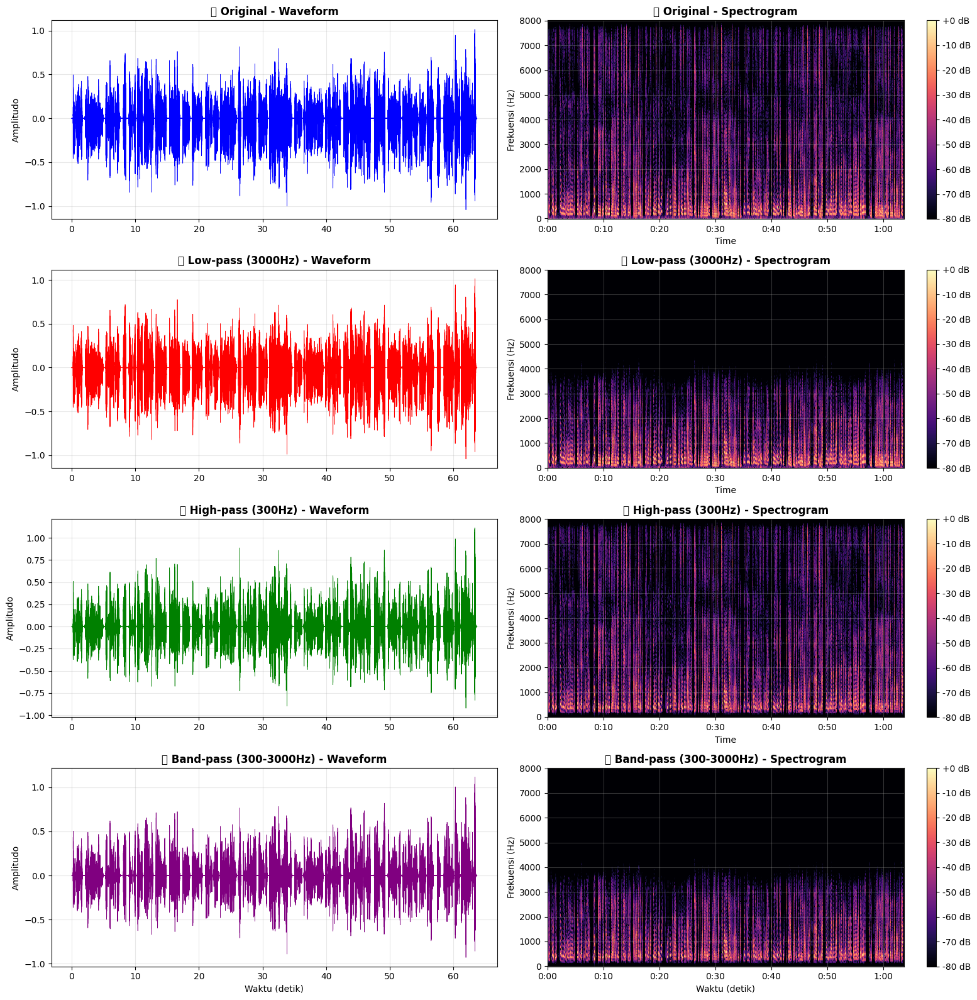

🔊 AUDIO COMPARISON:
Original Audio:


Low-pass Filtered (3000Hz cutoff):


High-pass Filtered (300Hz cutoff):


Band-pass Filtered (300-3000Hz):



✅ Filter berhasil diterapkan!
📊 Audio tersimpan untuk analisis lebih lanjut


In [6]:
# Hands-on: Low-pass dan High-pass Filter

print("🎛️ IMPLEMENTASI FILTER DASAR")
print("=" * 50)

# Gunakan audio yang sudah di-resample (16kHz untuk efisiensi)
audio_to_filter = y_16k
sample_rate = sr_16k

print(f"🎵 Menggunakan audio: {len(audio_to_filter):,} samples, {sample_rate:,} Hz")

# Parameter filter
lowpass_cutoff = 3000   # Hz - Low-pass cutoff
highpass_cutoff = 300   # Hz - High-pass cutoff
filter_order = 4        # Order filter (semakin tinggi = semakin tajam)

# 1. LOW-PASS FILTER (High-cut)
# Desain filter menggunakan scipy.signal.butter
nyquist = sample_rate / 2
lowpass_normalized = lowpass_cutoff / nyquist

# Membuat koefisien filter Butterworth
b_low, a_low = scipy.signal.butter(filter_order, lowpass_normalized, btype='low')

# Aplikasikan filter
audio_lowpass = scipy.signal.filtfilt(b_low, a_low, audio_to_filter)

print(f"✅ Low-pass filter applied: cutoff = {lowpass_cutoff} Hz")

# 2. HIGH-PASS FILTER (Low-cut)
highpass_normalized = highpass_cutoff / nyquist
b_high, a_high = scipy.signal.butter(filter_order, highpass_normalized, btype='high')
audio_highpass = scipy.signal.filtfilt(b_high, a_high, audio_to_filter)

print(f"✅ High-pass filter applied: cutoff = {highpass_cutoff} Hz")

# 3. BAND-PASS FILTER (kombinasi low dan high)
bandpass_low = 300   # Hz
bandpass_high = 3000 # Hz
bandpass_normalized = [bandpass_low / nyquist, bandpass_high / nyquist]
b_band, a_band = scipy.signal.butter(filter_order, bandpass_normalized, btype='band')
audio_bandpass = scipy.signal.filtfilt(b_band, a_band, audio_to_filter)

print(f"✅ Band-pass filter applied: {bandpass_low}-{bandpass_high} Hz")

# Visualisasi comparison
fig, axes = plt.subplots(4, 2, figsize=(16, 16))

# Function untuk plot spectrogram
def plot_audio_spectrum(audio, sr, ax_wave, ax_spec, title, color):
    # Waveform
    t = np.linspace(0, len(audio)/sr, len(audio))
    ax_wave.plot(t, audio, color=color, linewidth=0.5)
    ax_wave.set_title(f'🌊 {title} - Waveform', fontweight='bold')
    ax_wave.set_ylabel('Amplitudo')
    ax_wave.grid(True, alpha=0.3)
    
    # Spectrogram
    D = librosa.stft(audio, n_fft=512, hop_length=128)
    mag_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    img = librosa.display.specshow(mag_db, x_axis='time', y_axis='hz',
                                  sr=sr, hop_length=128, ax=ax_spec)
    ax_spec.set_title(f'📊 {title} - Spectrogram', fontweight='bold')
    ax_spec.set_ylabel('Frekuensi (Hz)')
    plt.colorbar(img, ax=ax_spec, format='%+2.0f dB')

# Plot semua audio
plot_audio_spectrum(audio_to_filter, sample_rate, axes[0,0], axes[0,1], 'Original', 'blue')
plot_audio_spectrum(audio_lowpass, sample_rate, axes[1,0], axes[1,1], f'Low-pass ({lowpass_cutoff}Hz)', 'red')
plot_audio_spectrum(audio_highpass, sample_rate, axes[2,0], axes[2,1], f'High-pass ({highpass_cutoff}Hz)', 'green')
plot_audio_spectrum(audio_bandpass, sample_rate, axes[3,0], axes[3,1], f'Band-pass ({bandpass_low}-{bandpass_high}Hz)', 'purple')

# Set xlabel untuk bottom plots
axes[3,0].set_xlabel('Waktu (detik)')
axes[3,1].set_xlabel('Waktu (detik)')

plt.tight_layout()
plt.show()

# Audio comparison
print("🔊 AUDIO COMPARISON:")
print("Original Audio:")
display(Audio(audio_to_filter, rate=sample_rate))
print(f"Low-pass Filtered ({lowpass_cutoff}Hz cutoff):")
display(Audio(audio_lowpass, rate=sample_rate))
print(f"High-pass Filtered ({highpass_cutoff}Hz cutoff):")
display(Audio(audio_highpass, rate=sample_rate))
print(f"Band-pass Filtered ({bandpass_low}-{bandpass_high}Hz):")
display(Audio(audio_bandpass, rate=sample_rate))

# Simpan hasil untuk penggunaan selanjutnya
print(f"\n✅ Filter berhasil diterapkan!")
print(f"📊 Audio tersimpan untuk analisis lebih lanjut")

📈 ANALISIS FREQUENCY RESPONSE


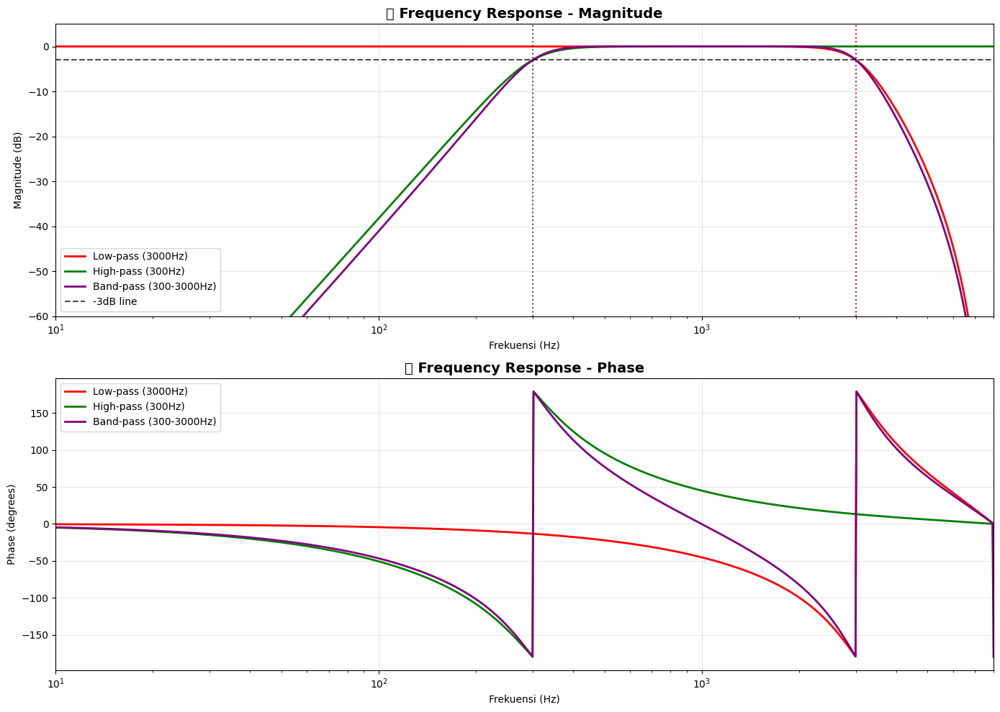

📊 KARAKTERISTIK FILTER:
🔴 Low-pass (3000Hz):
    - Roll-off: ~24 dB/oktaf
    - Efek: Mengurangi brightness, menghaluskan suara
🟢 High-pass (300Hz):
    - Roll-off: ~24 dB/oktaf
    - Efek: Menghilangkan rumble, membersihkan low-end
🟣 Band-pass (300-3000Hz):
    - Bandwidth: 2700 Hz
    - Efek: Isolasi midrange, cocok untuk vocal

⚡ ENERGY ANALYSIS:
Original:   1.37e+04 (100%)
Low-pass:   1.35e+04 (98.8%)
High-pass:  7.19e+03 (52.6%)
Band-pass:  7.30e+03 (53.3%)


In [7]:
# Analisis Frequency Response Filter

print("📈 ANALISIS FREQUENCY RESPONSE")
print("=" * 50)

# Hitung frequency response untuk setiap filter
frequencies = np.logspace(1, np.log10(sample_rate/2), 1000)  # 10 Hz to Nyquist

# Frequency response untuk setiap filter
w_low, h_low = scipy.signal.freqz(b_low, a_low, worN=frequencies, fs=sample_rate)
w_high, h_high = scipy.signal.freqz(b_high, a_high, worN=frequencies, fs=sample_rate)
w_band, h_band = scipy.signal.freqz(b_band, a_band, worN=frequencies, fs=sample_rate)

# Convert ke dB
h_low_db = 20 * np.log10(np.abs(h_low))
h_high_db = 20 * np.log10(np.abs(h_high))
h_band_db = 20 * np.log10(np.abs(h_band))

# Plot frequency response
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10))

# Magnitude response
ax1.semilogx(w_low, h_low_db, 'r-', linewidth=2, label=f'Low-pass ({lowpass_cutoff}Hz)')
ax1.semilogx(w_high, h_high_db, 'g-', linewidth=2, label=f'High-pass ({highpass_cutoff}Hz)')
ax1.semilogx(w_band, h_band_db, 'purple', linewidth=2, label=f'Band-pass ({bandpass_low}-{bandpass_high}Hz)')

# Tambahkan garis referensi
ax1.axhline(-3, color='black', linestyle='--', alpha=0.7, label='-3dB line')
ax1.axvline(lowpass_cutoff, color='red', linestyle=':', alpha=0.7)
ax1.axvline(highpass_cutoff, color='green', linestyle=':', alpha=0.7)
ax1.axvline(bandpass_low, color='purple', linestyle=':', alpha=0.5)
ax1.axvline(bandpass_high, color='purple', linestyle=':', alpha=0.5)

ax1.set_title('📈 Frequency Response - Magnitude', fontsize=14, fontweight='bold')
ax1.set_xlabel('Frekuensi (Hz)')
ax1.set_ylabel('Magnitude (dB)')
ax1.grid(True, alpha=0.3)
ax1.legend()
ax1.set_ylim([-60, 5])
ax1.set_xlim([10, sample_rate/2])

# Phase response
phase_low = np.angle(h_low) * 180 / np.pi
phase_high = np.angle(h_high) * 180 / np.pi
phase_band = np.angle(h_band) * 180 / np.pi

ax2.semilogx(w_low, phase_low, 'r-', linewidth=2, label=f'Low-pass ({lowpass_cutoff}Hz)')
ax2.semilogx(w_high, phase_high, 'g-', linewidth=2, label=f'High-pass ({highpass_cutoff}Hz)')
ax2.semilogx(w_band, phase_band, 'purple', linewidth=2, label=f'Band-pass ({bandpass_low}-{bandpass_high}Hz)')

ax2.set_title('📐 Frequency Response - Phase', fontsize=14, fontweight='bold')
ax2.set_xlabel('Frekuensi (Hz)')
ax2.set_ylabel('Phase (degrees)')
ax2.grid(True, alpha=0.3)
ax2.legend()
ax2.set_xlim([10, sample_rate/2])

plt.tight_layout()
plt.show()

# Analisis karakteristik filter
print("📊 KARAKTERISTIK FILTER:")
print(f"🔴 Low-pass ({lowpass_cutoff}Hz):")
print(f"    - Roll-off: ~{filter_order * 6} dB/oktaf")
print(f"    - Efek: Mengurangi brightness, menghaluskan suara")

print(f"🟢 High-pass ({highpass_cutoff}Hz):")
print(f"    - Roll-off: ~{filter_order * 6} dB/oktaf") 
print(f"    - Efek: Menghilangkan rumble, membersihkan low-end")

print(f"🟣 Band-pass ({bandpass_low}-{bandpass_high}Hz):")
print(f"    - Bandwidth: {bandpass_high - bandpass_low} Hz")
print(f"    - Efek: Isolasi midrange, cocok untuk vocal")

# Hitung energy content sebelum dan sesudah filtering
energy_orig = np.sum(audio_to_filter**2)
energy_low = np.sum(audio_lowpass**2)
energy_high = np.sum(audio_highpass**2)
energy_band = np.sum(audio_bandpass**2)

print(f"\n⚡ ENERGY ANALYSIS:")
print(f"Original:   {energy_orig:.2e} (100%)")
print(f"Low-pass:   {energy_low:.2e} ({100*energy_low/energy_orig:.1f}%)")
print(f"High-pass:  {energy_high:.2e} ({100*energy_high/energy_orig:.1f}%)")
print(f"Band-pass:  {energy_band:.2e} ({100*energy_band/energy_orig:.1f}%)")

🎚️ APLIKASI PRAKTIS EQUALIZATION
🧹 Rumble Removal: High-pass filter 80Hz
🎤 Vocal Isolation: Band-pass filter 85-4000Hz
🔇 Noise Cleanup: Notch filter 50Hz (Q=10)


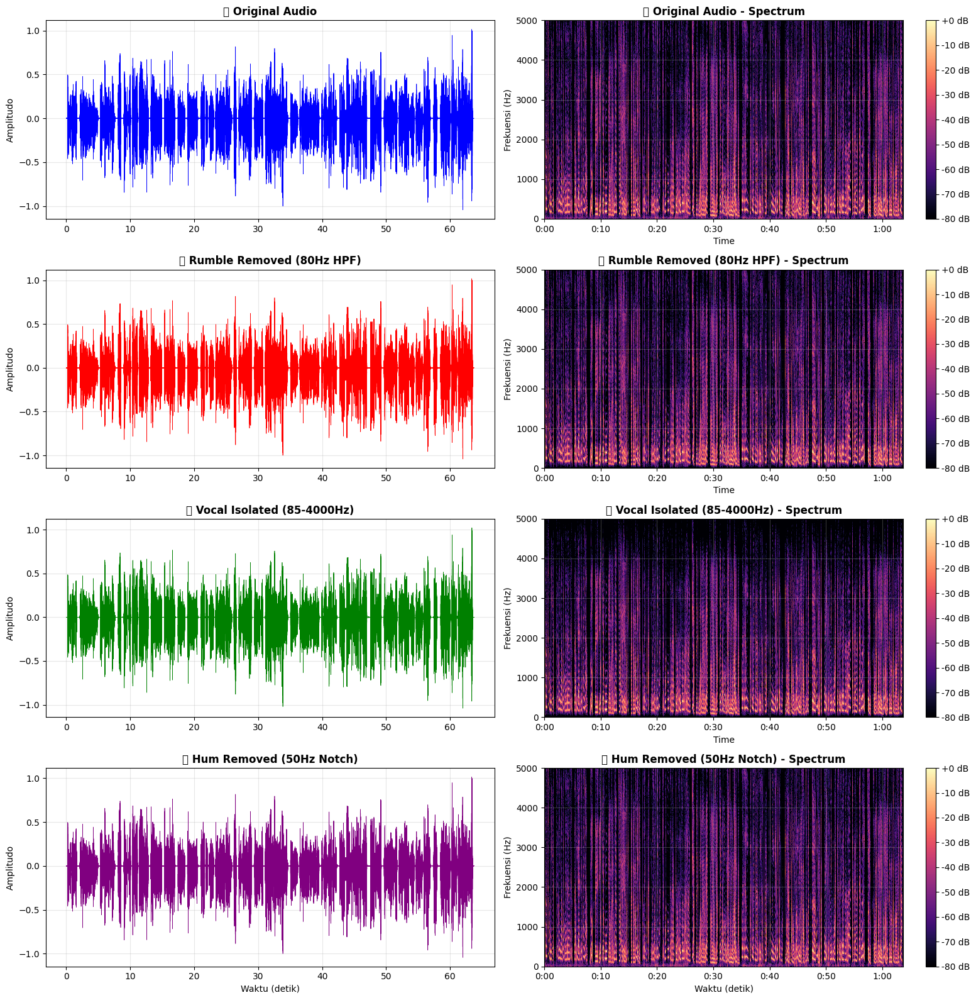

🔊 PRACTICAL EQ COMPARISON:
Original Audio:


Rumble Removed (HPF 80Hz):


Vocal Isolated (BPF 85-4000Hz):



📊 SPECTRAL ANALYSIS:
Original:
   Spectral Centroid: 1493.7 Hz
   Low (20-200Hz):   18.5%
   Mid (200-2kHz):   79.8%
   High (2k-8kHz):   1.7%
Rumble Removed:
   Spectral Centroid: 1524.2 Hz
   Low (20-200Hz):   15.9%
   Mid (200-2kHz):   82.4%
   High (2k-8kHz):   1.8%
Vocal Isolated:
   Spectral Centroid: 891.6 Hz
   Low (20-200Hz):   17.0%
   Mid (200-2kHz):   82.2%
   High (2k-8kHz):   0.9%

✅ Aplikasi praktis EQ berhasil diterapkan!
🎯 Perhatikan perubahan distribusi energi spektral
Original:
   Spectral Centroid: 1493.7 Hz
   Low (20-200Hz):   18.5%
   Mid (200-2kHz):   79.8%
   High (2k-8kHz):   1.7%
Rumble Removed:
   Spectral Centroid: 1524.2 Hz
   Low (20-200Hz):   15.9%
   Mid (200-2kHz):   82.4%
   High (2k-8kHz):   1.8%
Vocal Isolated:
   Spectral Centroid: 891.6 Hz
   Low (20-200Hz):   17.0%
   Mid (200-2kHz):   82.2%
   High (2k-8kHz):   0.9%

✅ Aplikasi praktis EQ berhasil diterapkan!
🎯 Perhatikan perubahan distribusi energi spektral


In [8]:
# Aplikasi Praktis EQ: Rumble Removal & Vocal Isolation

print("🎚️ APLIKASI PRAKTIS EQUALIZATION")
print("=" * 50)

# 1. RUMBLE REMOVAL (High-pass filter untuk menghilangkan low-frequency noise)
rumble_cutoff = 80  # Hz - Frekuensi cutoff untuk rumble removal
print(f"🧹 Rumble Removal: High-pass filter {rumble_cutoff}Hz")

# Desain filter rumble removal
rumble_normalized = rumble_cutoff / (sample_rate / 2)
b_rumble, a_rumble = scipy.signal.butter(2, rumble_normalized, btype='high')
audio_derumbled = scipy.signal.filtfilt(b_rumble, a_rumble, audio_to_filter)

# 2. VOCAL ISOLATION (Band-pass filter untuk fokus pada range vokal)
vocal_low = 85    # Hz - Lower bound vocal range
vocal_high = 4000  # Hz - Upper bound vocal range  
print(f"🎤 Vocal Isolation: Band-pass filter {vocal_low}-{vocal_high}Hz")

vocal_normalized = [vocal_low / (sample_rate / 2), vocal_high / (sample_rate / 2)]
b_vocal, a_vocal = scipy.signal.butter(3, vocal_normalized, btype='band')
audio_vocal = scipy.signal.filtfilt(b_vocal, a_vocal, audio_to_filter)

# 3. NOISE CLEANUP (Notch filter untuk 50Hz hum - disesuaikan untuk sample rate)
# Note: 50Hz mungkin tidak terlihat pada sample 16kHz, tapi kita demo untuk pembelajaran
hum_freq = 50  # Hz - Power line hum frequency
hum_q = 10     # Q factor - semakin tinggi = semakin tajam
print(f"🔇 Noise Cleanup: Notch filter {hum_freq}Hz (Q={hum_q})")

if hum_freq < sample_rate / 2:  # Pastikan dalam range Nyquist
    hum_normalized = hum_freq / (sample_rate / 2)
    b_notch, a_notch = scipy.signal.iirnotch(hum_normalized, hum_q)
    audio_dehummed = scipy.signal.filtfilt(b_notch, a_notch, audio_to_filter)
else:
    audio_dehummed = audio_to_filter.copy()
    print("   ⚠️ Hum frequency di luar range, menggunakan audio original")

# Visualisasi perbandingan aplikasi praktis
fig, axes = plt.subplots(4, 2, figsize=(16, 16))

# Function untuk plot yang lebih kompak
def plot_practical_eq(audio, sr, ax_wave, ax_spec, title, color):
    # Waveform
    t = np.linspace(0, len(audio)/sr, len(audio))
    ax_wave.plot(t, audio, color=color, linewidth=0.5)
    ax_wave.set_title(f'🌊 {title}', fontweight='bold')
    ax_wave.set_ylabel('Amplitudo')
    ax_wave.grid(True, alpha=0.3)
    
    # Spectrogram dengan fokus pada low-frequency untuk melihat rumble
    D = librosa.stft(audio, n_fft=1024, hop_length=256)
    mag_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)
    img = librosa.display.specshow(mag_db, x_axis='time', y_axis='hz',
                                  sr=sr, hop_length=256, ax=ax_spec)
    ax_spec.set_title(f'📊 {title} - Spectrum', fontweight='bold')
    ax_spec.set_ylabel('Frekuensi (Hz)')
    ax_spec.set_ylim([0, 5000])  # Focus pada 0-5kHz untuk melihat perubahan
    plt.colorbar(img, ax=ax_spec, format='%+2.0f dB')

# Plot semua hasil
plot_practical_eq(audio_to_filter, sample_rate, axes[0,0], axes[0,1], 'Original Audio', 'blue')
plot_practical_eq(audio_derumbled, sample_rate, axes[1,0], axes[1,1], f'Rumble Removed ({rumble_cutoff}Hz HPF)', 'red')
plot_practical_eq(audio_vocal, sample_rate, axes[2,0], axes[2,1], f'Vocal Isolated ({vocal_low}-{vocal_high}Hz)', 'green')
plot_practical_eq(audio_dehummed, sample_rate, axes[3,0], axes[3,1], f'Hum Removed ({hum_freq}Hz Notch)', 'purple')

# Set labels
axes[3,0].set_xlabel('Waktu (detik)')
axes[3,1].set_xlabel('Waktu (detik)')

plt.tight_layout()
plt.show()

# Audio comparison untuk aplikasi praktis
print("🔊 PRACTICAL EQ COMPARISON:")
print("Original Audio:")
display(Audio(audio_to_filter, rate=sample_rate))
print(f"Rumble Removed (HPF {rumble_cutoff}Hz):")
display(Audio(audio_derumbled, rate=sample_rate))
print(f"Vocal Isolated (BPF {vocal_low}-{vocal_high}Hz):")
display(Audio(audio_vocal, rate=sample_rate))

# Analisis spektral untuk melihat efek filtering
print(f"\n📊 SPECTRAL ANALYSIS:")

def calculate_spectral_stats(audio, sr, name):
    # Hitung FFT untuk analisis spektral
    fft = np.fft.rfft(audio)
    freqs = np.fft.rfftfreq(len(audio), 1/sr)
    magnitude = np.abs(fft)
    
    # Hitung spectral centroid (center of mass frequency)
    spectral_centroid = np.sum(freqs * magnitude) / np.sum(magnitude)
    
    # Hitung energy di berbagai band
    low_band = (freqs >= 20) & (freqs <= 200)
    mid_band = (freqs >= 200) & (freqs <= 2000)
    high_band = (freqs >= 2000) & (freqs <= sr/2)
    
    low_energy = np.sum(magnitude[low_band]**2)
    mid_energy = np.sum(magnitude[mid_band]**2)
    high_energy = np.sum(magnitude[high_band]**2)
    total_energy = low_energy + mid_energy + high_energy
    
    print(f"{name}:")
    print(f"   Spectral Centroid: {spectral_centroid:.1f} Hz")
    print(f"   Low (20-200Hz):   {100*low_energy/total_energy:.1f}%")
    print(f"   Mid (200-2kHz):   {100*mid_energy/total_energy:.1f}%") 
    print(f"   High (2k-8kHz):   {100*high_energy/total_energy:.1f}%")

calculate_spectral_stats(audio_to_filter, sample_rate, "Original")
calculate_spectral_stats(audio_derumbled, sample_rate, "Rumble Removed")
calculate_spectral_stats(audio_vocal, sample_rate, "Vocal Isolated")

print(f"\n✅ Aplikasi praktis EQ berhasil diterapkan!")
print(f"🎯 Perhatikan perubahan distribusi energi spektral")

🎛️ CUSTOM MULTI-BAND EQUALIZER
🎚️ 4-Band EQ Design:
   🔵 Band 1 (Low):      20-200Hz   - Bass control
   🟢 Band 2 (Low-Mid):  200-800Hz  - Warmth control
   🟡 Band 3 (High-Mid): 800-4kHz   - Presence control
   🔴 Band 4 (High):     4k-8kHz    - Brightness control

🎯 EQ Settings:
   Low: -3.0 dB
   Low-Mid: +2.0 dB
   High-Mid: +4.0 dB
   High: -1.0 dB
⚠️ Audio dinormalisasi untuk mencegah clipping (factor: 0.598)


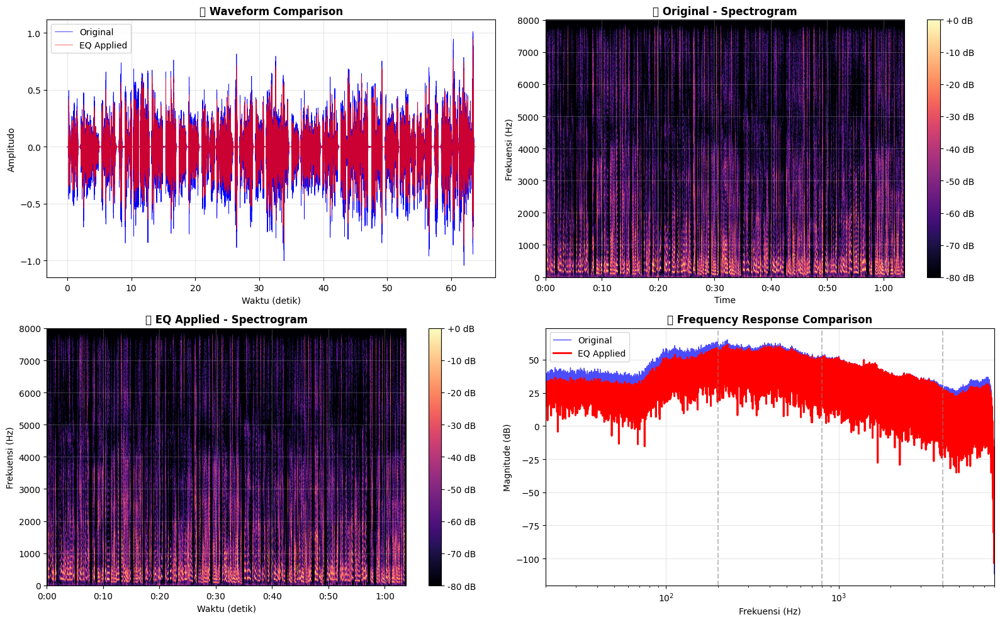

🔊 CUSTOM EQ COMPARISON:
Original Audio:


Custom EQ Applied:



📊 EQ IMPACT ANALYSIS:
Before EQ:
   Spectral Centroid: 1493.7 Hz
   Low (20-200Hz):   18.5%
   Mid (200-2kHz):   79.8%
   High (2k-8kHz):   1.7%
After EQ:
   Spectral Centroid: 1421.9 Hz
   Low (20-200Hz):   9.4%
   Mid (200-2kHz):   88.6%
   High (2k-8kHz):   2.0%

✅ Custom 4-band EQ berhasil diterapkan!
🎯 Perhatikan perubahan karakter suara sesuai setting EQ
Before EQ:
   Spectral Centroid: 1493.7 Hz
   Low (20-200Hz):   18.5%
   Mid (200-2kHz):   79.8%
   High (2k-8kHz):   1.7%
After EQ:
   Spectral Centroid: 1421.9 Hz
   Low (20-200Hz):   9.4%
   Mid (200-2kHz):   88.6%
   High (2k-8kHz):   2.0%

✅ Custom 4-band EQ berhasil diterapkan!
🎯 Perhatikan perubahan karakter suara sesuai setting EQ


In [9]:
# Custom EQ Design: Multi-Band Equalizer

print("🎛️ CUSTOM MULTI-BAND EQUALIZER")
print("=" * 50)

# Desain EQ 4-band seperti pada mixer profesional
# Band 1: Low (20-200Hz) - Bass control
# Band 2: Low-Mid (200-800Hz) - Warmth/Muddiness  
# Band 3: High-Mid (800-4kHz) - Presence/Clarity
# Band 4: High (4k-8kHz) - Brightness/Air

print("🎚️ 4-Band EQ Design:")
print("   🔵 Band 1 (Low):      20-200Hz   - Bass control")
print("   🟢 Band 2 (Low-Mid):  200-800Hz  - Warmth control") 
print("   🟡 Band 3 (High-Mid): 800-4kHz   - Presence control")
print("   🔴 Band 4 (High):     4k-8kHz    - Brightness control")

# Parameter EQ (gain dalam dB untuk setiap band)
eq_gains = {
    'low': -3,      # Kurangi bass sedikit
    'low_mid': +2,  # Tambah warmth
    'high_mid': +4, # Boost presence untuk clarity
    'high': -1      # Kurangi brightness sedikit
}

print(f"\n🎯 EQ Settings:")
for band, gain in eq_gains.items():
    print(f"   {band.replace('_', '-').title()}: {gain:+.1f} dB")

# Implementasi multi-band EQ menggunakan cascaded filters
def apply_multiband_eq(audio, sr, gains):
    """
    Aplikasikan multi-band EQ dengan gain adjustment
    """
    processed_audio = audio.copy()
    nyquist = sr / 2
    
    # Band 1: Low (20-200Hz) - Shelving filter
    if gains['low'] != 0:
        freq_norm = 200 / nyquist
        b, a = scipy.signal.butter(2, freq_norm, btype='low')
        low_band = scipy.signal.filtfilt(b, a, audio)
        gain_linear = 10**(gains['low']/20)  # Convert dB to linear
        processed_audio += low_band * (gain_linear - 1)
    
    # Band 2: Low-Mid (200-800Hz) - Band-pass filter
    if gains['low_mid'] != 0:
        freq_norm = [200/nyquist, 800/nyquist]
        b, a = scipy.signal.butter(2, freq_norm, btype='band')
        low_mid_band = scipy.signal.filtfilt(b, a, audio)
        gain_linear = 10**(gains['low_mid']/20)
        processed_audio += low_mid_band * (gain_linear - 1)
    
    # Band 3: High-Mid (800-4000Hz) - Band-pass filter  
    if gains['high_mid'] != 0:
        freq_norm = [800/nyquist, 4000/nyquist]
        b, a = scipy.signal.butter(2, freq_norm, btype='band')
        high_mid_band = scipy.signal.filtfilt(b, a, audio)
        gain_linear = 10**(gains['high_mid']/20)
        processed_audio += high_mid_band * (gain_linear - 1)
    
    # Band 4: High (4000Hz+) - High-pass filter
    if gains['high'] != 0:
        freq_norm = 4000 / nyquist
        b, a = scipy.signal.butter(2, freq_norm, btype='high')
        high_band = scipy.signal.filtfilt(b, a, audio)
        gain_linear = 10**(gains['high']/20)
        processed_audio += high_band * (gain_linear - 1)
    
    return processed_audio

# Aplikasikan custom EQ
audio_eq = apply_multiband_eq(audio_to_filter, sample_rate, eq_gains)

# Normalisasi untuk mencegah clipping
max_val = np.max(np.abs(audio_eq))
if max_val > 0.95:
    audio_eq = audio_eq * (0.95 / max_val)
    print(f"⚠️ Audio dinormalisasi untuk mencegah clipping (factor: {0.95/max_val:.3f})")

# Visualisasi perbandingan dengan EQ
fig, axes = plt.subplots(2, 2, figsize=(16, 10))

# Plot 1: Waveform comparison
t = np.linspace(0, len(audio_to_filter)/sample_rate, len(audio_to_filter))
axes[0,0].plot(t, audio_to_filter, 'b-', linewidth=0.5, label='Original')
axes[0,0].plot(t, audio_eq, 'r-', linewidth=0.5, alpha=0.8, label='EQ Applied')
axes[0,0].set_title('🌊 Waveform Comparison', fontweight='bold')
axes[0,0].set_xlabel('Waktu (detik)')
axes[0,0].set_ylabel('Amplitudo')
axes[0,0].legend()
axes[0,0].grid(True, alpha=0.3)

# Plot 2: Spectrogram original
D_orig = librosa.stft(audio_to_filter, n_fft=1024, hop_length=256)
mag_orig_db = librosa.amplitude_to_db(np.abs(D_orig), ref=np.max)
img1 = librosa.display.specshow(mag_orig_db, x_axis='time', y_axis='hz',
                               sr=sample_rate, hop_length=256, ax=axes[0,1])
axes[0,1].set_title('📊 Original - Spectrogram', fontweight='bold')
axes[0,1].set_ylabel('Frekuensi (Hz)')
plt.colorbar(img1, ax=axes[0,1], format='%+2.0f dB')

# Plot 3: Spectrogram EQ
D_eq = librosa.stft(audio_eq, n_fft=1024, hop_length=256)
mag_eq_db = librosa.amplitude_to_db(np.abs(D_eq), ref=np.max)
img2 = librosa.display.specshow(mag_eq_db, x_axis='time', y_axis='hz',
                               sr=sample_rate, hop_length=256, ax=axes[1,0])
axes[1,0].set_title('📊 EQ Applied - Spectrogram', fontweight='bold')
axes[1,0].set_xlabel('Waktu (detik)')
axes[1,0].set_ylabel('Frekuensi (Hz)')
plt.colorbar(img2, ax=axes[1,0], format='%+2.0f dB')

# Plot 4: Frequency response comparison
fft_orig = np.fft.rfft(audio_to_filter)
fft_eq = np.fft.rfft(audio_eq)
freqs = np.fft.rfftfreq(len(audio_to_filter), 1/sample_rate)

mag_orig = 20 * np.log10(np.abs(fft_orig) + 1e-10)
mag_eq = 20 * np.log10(np.abs(fft_eq) + 1e-10)

axes[1,1].semilogx(freqs[1:], mag_orig[1:], 'b-', linewidth=1, label='Original', alpha=0.7)
axes[1,1].semilogx(freqs[1:], mag_eq[1:], 'r-', linewidth=2, label='EQ Applied')

# Tambahkan garis pembatas band
axes[1,1].axvline(200, color='gray', linestyle='--', alpha=0.5)
axes[1,1].axvline(800, color='gray', linestyle='--', alpha=0.5) 
axes[1,1].axvline(4000, color='gray', linestyle='--', alpha=0.5)

axes[1,1].set_title('📈 Frequency Response Comparison', fontweight='bold')
axes[1,1].set_xlabel('Frekuensi (Hz)')
axes[1,1].set_ylabel('Magnitude (dB)')
axes[1,1].legend()
axes[1,1].grid(True, alpha=0.3)
axes[1,1].set_xlim([20, sample_rate/2])

plt.tight_layout()
plt.show()

# Audio comparison
print("🔊 CUSTOM EQ COMPARISON:")
print("Original Audio:")
display(Audio(audio_to_filter, rate=sample_rate))
print("Custom EQ Applied:")
display(Audio(audio_eq, rate=sample_rate))

# Analisis perubahan spektral
print(f"\n📊 EQ IMPACT ANALYSIS:")
calculate_spectral_stats(audio_to_filter, sample_rate, "Before EQ")
calculate_spectral_stats(audio_eq, sample_rate, "After EQ")

print(f"\n✅ Custom 4-band EQ berhasil diterapkan!")
print(f"🎯 Perhatikan perubahan karakter suara sesuai setting EQ")

## Ringkasan & Kesimpulan Week 1

Selamat! Anda telah berhasil mempelajari konsep fundamental signal processing, resampling, dan equalization. Mari kita ringkas apa yang telah dipelajari:

### 🎯 **Konsep Utama yang Dipelajari:**

#### 1. **Resampling**
- ✅ **Upsampling**: Meningkatkan sample rate dengan interpolasi
- ✅ **Downsampling**: Mengurangi sample rate dengan decimation
- ✅ **Anti-aliasing**: Pentingnya filtering sebelum downsampling
- ✅ **Praktik**: Konversi 44.1kHz → 16kHz dengan hasil berkualitas

#### 2. **Audio Filtering**
- ✅ **Low-pass Filter**: Menghilangkan frekuensi tinggi (high-cut)
- ✅ **High-pass Filter**: Menghilangkan frekuensi rendah (low-cut)  
- ✅ **Band-pass Filter**: Isolasi rentang frekuensi tertentu
- ✅ **Notch Filter**: Menghilangkan frekuensi spesifik (hum removal)

#### 3. **Practical Applications**
- ✅ **Rumble Removal**: HPF untuk membersihkan low-frequency noise
- ✅ **Vocal Isolation**: BPF untuk fokus pada range vokal
- ✅ **Noise Cleanup**: Notch filter untuk power line hum
- ✅ **Custom EQ**: Multi-band equalizer untuk audio enhancement

### 🔧 **Tools & Techniques:**
- `librosa.resample()` untuk resampling berkualitas tinggi
- `scipy.signal.butter()` untuk desain filter Butterworth
- `scipy.signal.filtfilt()` untuk zero-phase filtering
- `scipy.signal.freqz()` untuk analisis frequency response
- Visualisasi spectrogram untuk analisis spektral

### 🎵 **Key Takeaways:**

1. **Resampling bukan sekedar decimation** - Perlu anti-aliasing filter untuk hasil berkualitas
2. **Filter order menentukan ketajaman** - Higher order = steeper roll-off
3. **EQ adalah seni dan sains** - Kombinasi pengetahuan teknis dan telinga musical
4. **Frequency response analysis penting** - Memahami karakteristik filter sebelum aplikasi
5. **Audio processing preserves duration** - Filtering tidak mengubah panjang audio

### 🚀 **Next Steps:**
- Week 2: Advanced filtering (FIR vs IIR, windowing)
- Week 3: Time-frequency analysis (STFT, wavelets)
- Week 4: Audio effects (reverb, delay, modulation)
- Week 5: Machine learning applications

### 💡 **Pro Tips:**
- Selalu dengarkan hasil processing dengan telinga Anda
- Gunakan visualisasi spectrum untuk memahami perubahan
- Mulai dengan setting gentle, avoid extreme processing
- Backup audio original sebelum processing chain yang kompleks